In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib as plt
import plotly.graph_objects as go

In [2]:
df = pd.read_csv(r"C:\Users\Tim\Downloads\dataset_2019_2022.csv")

In [3]:
df.head(5)

,customer_id,product_id,basket_id,loyalty,household_type,age_band,department,brand,commodity,store,price,transaction_date
0,15803,1131974,57266,Loyalist,1 adult with kids,19-24,Grocery,private,Baked bread/buns/rolls,374,0.99,5/10/2020
1,15803,1051516,57266,Loyalist,1 adult with kids,19-24,Produce,national,Vegetables - all others,374,0.70,24/10/2020
2,15803,967254,57266,Loyalist,1 adult with kids,19-24,Pharmaceutical,national,Cold and flu,374,1.68,18/10/2020
3,15803,1134222,57266,Loyalist,1 adult with kids,19-24,Grocery,private,Paper housewares,374,2.59,23/10/2020
4,15803,1003421,57266,Loyalist,1 adult with kids,19-24,Grocery,national,Soup,374,0.60,27/10/2020


In [4]:
df.head(100000)

,customer_id,product_id,basket_id,loyalty,household_type,age_band,department,brand,commodity,store,price,transaction_date
0,15803,1131974,57266,Loyalist,1 adult with kids,19-24,Grocery,private,Baked bread/buns/rolls,374,0.99,5/10/2020
1,15803,1051516,57266,Loyalist,1 adult with kids,19-24,Produce,national,Vegetables - all others,374,0.70,24/10/2020
2,15803,967254,57266,Loyalist,1 adult with kids,19-24,Pharmaceutical,national,Cold and flu,374,1.68,18/10/2020
3,15803,1134222,57266,Loyalist,1 adult with kids,19-24,Grocery,private,Paper housewares,374,2.59,23/10/2020
4,15803,1003421,57266,Loyalist,1 adult with kids,19-24,Grocery,national,Soup,374,0.60,27/10/2020
...,...,...,...,...,...,...,...,...,...,...,...,...
77745,36987,860776,80984,Promiscuous,2 adults with kids,45-54,Produce,national,Vegetables - all others,374,0.79,14/07/2020
77746,36987,1060673,80984,Promiscuous,2 adults with kids,45-54,Meat,national,Lunch meat,374,3.00,24/07/2020
77747,36987,973374,80984,Promiscuous,2 adults with kids,45-54,Produce,private,Onions,374,1.99,3/07/2020
77748,36987,13506200,80984,Promiscuous,2 adults with kids,45-54,Meat,national,Beef,374,4.92,6/07/2020


In [5]:
columns_to_drop = ['store', 'basket_id', 'department', 'product_id']

df.drop(columns=columns_to_drop, inplace=True)
df

,customer_id,loyalty,household_type,age_band,brand,commodity,price,transaction_date
0,15803,Loyalist,1 adult with kids,19-24,private,Baked bread/buns/rolls,0.99,5/10/2020
1,15803,Loyalist,1 adult with kids,19-24,national,Vegetables - all others,0.70,24/10/2020
2,15803,Loyalist,1 adult with kids,19-24,national,Cold and flu,1.68,18/10/2020
3,15803,Loyalist,1 adult with kids,19-24,private,Paper housewares,2.59,23/10/2020
4,15803,Loyalist,1 adult with kids,19-24,national,Soup,0.60,27/10/2020
...,...,...,...,...,...,...,...,...
77745,36987,Promiscuous,2 adults with kids,45-54,national,Vegetables - all others,0.79,14/07/2020
77746,36987,Promiscuous,2 adults with kids,45-54,national,Lunch meat,3.00,24/07/2020
77747,36987,Promiscuous,2 adults with kids,45-54,private,Onions,1.99,3/07/2020
77748,36987,Promiscuous,2 adults with kids,45-54,national,Beef,4.92,6/07/2020


In [6]:
df.rename(columns={'customer_id': 'Customer', 'household_type':'Household','age_band':'Age', 'commodity':'Commodity','transaction_date':'Date', 'price':'Price', 'loyalty':'Loyalty', 'brand': 'Brand'}, inplace=True)
df

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
0,15803,Loyalist,1 adult with kids,19-24,private,Baked bread/buns/rolls,0.99,5/10/2020
1,15803,Loyalist,1 adult with kids,19-24,national,Vegetables - all others,0.70,24/10/2020
2,15803,Loyalist,1 adult with kids,19-24,national,Cold and flu,1.68,18/10/2020
3,15803,Loyalist,1 adult with kids,19-24,private,Paper housewares,2.59,23/10/2020
4,15803,Loyalist,1 adult with kids,19-24,national,Soup,0.60,27/10/2020
...,...,...,...,...,...,...,...,...
77745,36987,Promiscuous,2 adults with kids,45-54,national,Vegetables - all others,0.79,14/07/2020
77746,36987,Promiscuous,2 adults with kids,45-54,national,Lunch meat,3.00,24/07/2020
77747,36987,Promiscuous,2 adults with kids,45-54,private,Onions,1.99,3/07/2020
77748,36987,Promiscuous,2 adults with kids,45-54,national,Beef,4.92,6/07/2020


# Finding the Top 5 Commodities 

In [7]:
df.groupby(['Commodity']).agg(total_revenue=('Price',sum)) \
    .sort_values('total_revenue', ascending = False).head(5)

,total_revenue
Commodity,
Beef,17317.96
Cheese,6372.04
Frozen meat,6244.27
Deli meats,5915.40
Seafood-frozen,5762.80


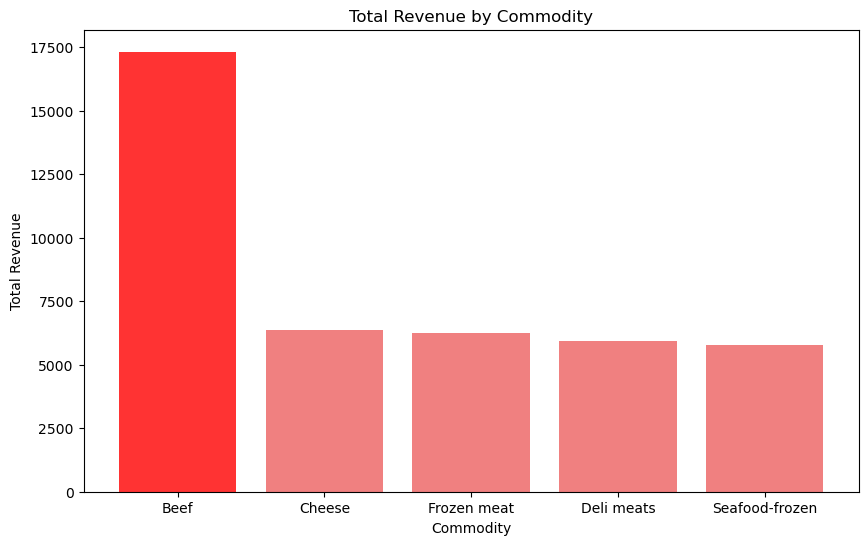

In [8]:
import matplotlib.pyplot as plt

top_5 = df.groupby(['Commodity']).agg(total_revenue=('Price', sum)) \
    .sort_values('total_revenue', ascending=False).head(5)

bar_colours = ['#FF3333', 'lightcoral', 'lightcoral', 'lightcoral', 'lightcoral']

plt.figure(figsize=(10, 6))
plt.bar(top_5.index, top_5['total_revenue'], color=bar_colours) 
plt.title('Total Revenue by Commodity')
plt.xlabel('Commodity')
plt.ylabel('Total Revenue')
plt.show()

## Top 5 Commodities Amonst the Household Groups

In [9]:
df.groupby(['Household',]).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

,Total_Revenue
Household,
2 adults with kids,73075.59
1 adult with kids,60847.26
2 adults with no kids,55455.15
Single male,39440.96
Single female,22395.92


In [10]:
tmp = df.groupby(['Household','Commodity']).agg(Total_Revenue=('Price',sum)).reset_index()
pd.concat(
    [tmp[tmp.Household == hh] \
         .sort_values('Total_Revenue', ascending=False) \
     .head(1) for hh in tmp.Household.unique()])

,Household,Commodity,Total_Revenue
19,1 adult with kids,Beef,4123.45
261,2 adults with kids,Beef,5070.47
507,2 adults with no kids,Beef,3643.65
751,Single female,Beef,1643.55
979,Single male,Beef,2836.84


#### Dividing the Table into Household_Type Single Female First 

In [11]:
singlef = df[df["Household"] == "Single female"]

singlef.head(100000)

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
20,15811,Promiscuous,Single female,19-24,national,Water - carbonated/flavoured drinks,9.98,18/10/2021
21,15811,Promiscuous,Single female,19-24,national,Candy,0.89,11/10/2021
22,15811,Promiscuous,Single female,19-24,national,Makeup and treatment,1.25,13/10/2021
23,15811,Promiscuous,Single female,19-24,national,Dishwash detergents,3.49,1/10/2021
24,15811,Promiscuous,Single female,19-24,national,Soft drinks,1.29,1/10/2021
...,...,...,...,...,...,...,...,...
77698,36929,Promiscuous,Single female,19-24,national,Oral hygiene products,2.99,31/07/2021
77699,36929,Promiscuous,Single female,19-24,national,Candy,0.50,13/07/2021
77700,36929,Promiscuous,Single female,19-24,national,Rolls,1.29,1/07/2021
77701,36929,Promiscuous,Single female,19-24,national,Rolls,0.34,1/07/2021


In [12]:
singlef.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)


,Total_Revenue
Commodity,
Beef,1643.55
Seafood-frozen,726.62
Cheese,612.69
Frozen meat,590.65
Lunch meat,526.76


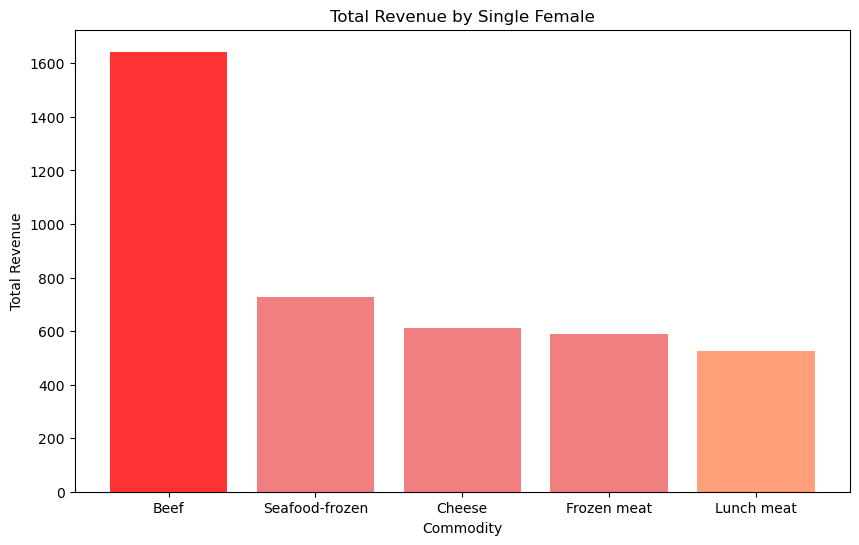

In [13]:
top_5_1 = singlef.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

bar_colours = ['#FF3333', 'lightcoral', 'lightcoral', 'lightcoral', 'lightsalmon']

plt.figure(figsize=(10, 6))
plt.bar(top_5_1.index, top_5_1['Total_Revenue'], color=bar_colours)  
plt.title('Total Revenue by Single Female')  
plt.xlabel('Commodity')
plt.ylabel('Total Revenue')
plt.show()

#### Dividing the Table into Household_Type Single Male  

In [14]:
malef = df[df["Household"] == "Single male"]

malef.head(100000)

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
159,15855,Loyalist,Single male,19-24,national,Frozen meat,2.00,28/10/2021
160,15855,Loyalist,Single male,19-24,national,Coffee,7.69,29/10/2021
161,15855,Loyalist,Single male,19-24,national,Facial tissues,1.79,3/10/2021
162,15855,Loyalist,Single male,19-24,national,Household cleaning needs,2.50,4/10/2021
163,15855,Loyalist,Single male,19-24,private,Pasta sauce,0.79,5/10/2021
...,...,...,...,...,...,...,...,...
77413,36651,Promiscuous,Single male,19-24,national,Cheese,1.74,13/06/2021
77414,36651,Promiscuous,Single male,19-24,national,Tomatoes,2.75,30/06/2021
77415,36651,Promiscuous,Single male,19-24,national,Pies,0.99,1/06/2021
77416,36651,Promiscuous,Single male,19-24,national,Stationery/school supplies,2.34,28/06/2021


In [15]:
malef.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

,Total_Revenue
Commodity,
Beef,2836.84
Seafood-frozen,1358.42
Deli meats,1033.32
Cheese,975.33
Frozen meat,952.35


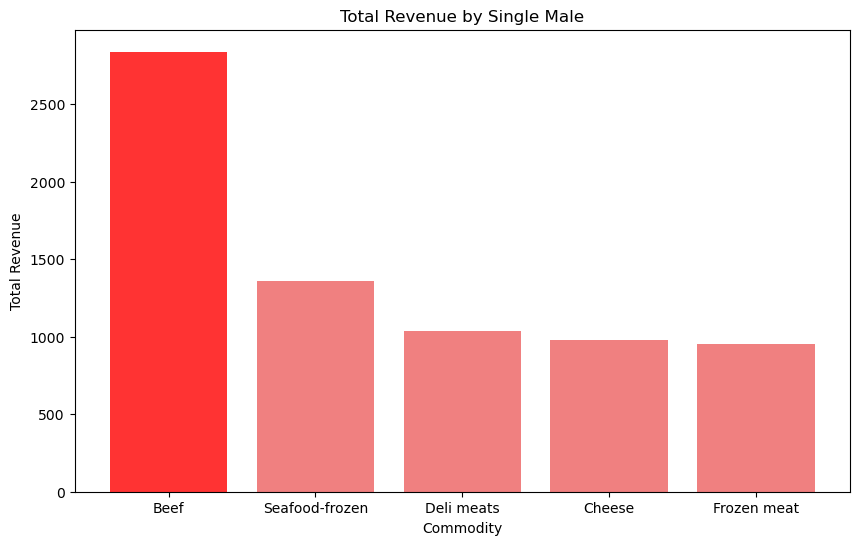

In [16]:
top_5_2 = malef.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

bar_colours = ['#FF3333', 'lightcoral', 'lightcoral', 'lightcoral', 'lightcoral']

plt.figure(figsize=(10, 6))
plt.bar(top_5_2.index, top_5_2['Total_Revenue'], color=bar_colours)  
plt.title('Total Revenue by Single Male')  
plt.xlabel('Commodity')
plt.ylabel('Total Revenue')
plt.show()

#### Dividing the Table into Household_Type 2 adults with no kids	

In [17]:
twoadultsf = df[df["Household"] == "2 adults with no kids"]

twoadultsf.head(100000)

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
66,15818,Loyalist,2 adults with no kids,19-24,national,Dog foods,7.99,7/12/2019
67,15818,Loyalist,2 adults with no kids,19-24,national,Refrigerated dough products,1.00,8/12/2019
68,15818,Loyalist,2 adults with no kids,19-24,private,Meat - Other,0.80,15/12/2019
69,15818,Loyalist,2 adults with no kids,19-24,national,Snack nuts,8.99,26/12/2019
70,15818,Loyalist,2 adults with no kids,19-24,private,Cheese,2.99,3/12/2019
...,...,...,...,...,...,...,...,...
77531,36792,Loyalist,2 adults with no kids,19-24,national,Lunch meat,1.99,27/07/2021
77532,36792,Loyalist,2 adults with no kids,19-24,national,Feminine hygiene,2.50,7/07/2021
77533,36792,Loyalist,2 adults with no kids,19-24,national,Seafood-frozen,4.99,3/07/2021
77534,36792,Loyalist,2 adults with no kids,19-24,national,Pies,2.50,18/07/2021


In [18]:
twoadultsf.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

,Total_Revenue
Commodity,
Beef,3643.65
Seafood-frozen,2100.00
Cheese,1340.66
Frozen meat,1299.39
Salad,1241.16


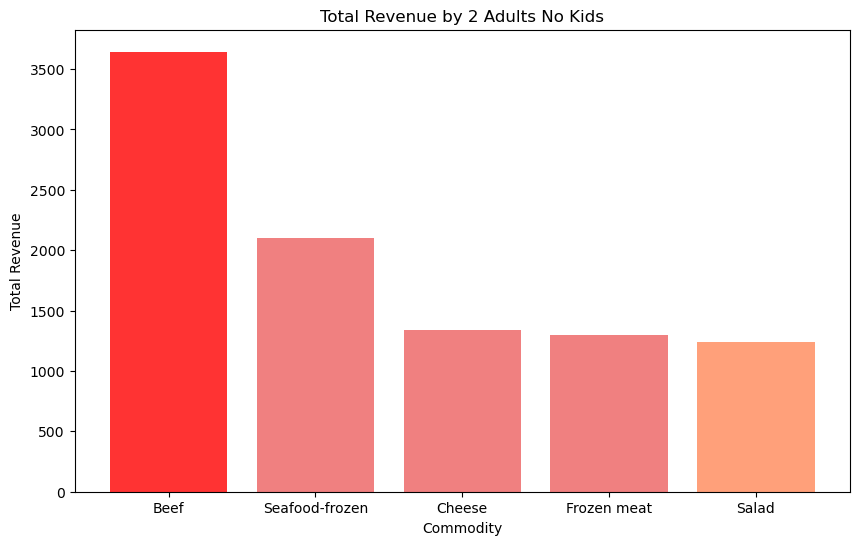

In [19]:
top_5_3 = twoadultsf.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

bar_colours = ['#FF3333', 'lightcoral', 'lightcoral', 'lightcoral', 'lightsalmon']

plt.figure(figsize=(10, 6))
plt.bar(top_5_3.index, top_5_3['Total_Revenue'], color=bar_colours)  
plt.title('Total Revenue by 2 Adults No Kids')  
plt.xlabel('Commodity')
plt.ylabel('Total Revenue')
plt.show()

#### Dividing the Table into Household_Type 2 adults with kids

In [20]:
twoadultskidsf = df[df["Household"] == "2 adults with kids"]

twoadultskidsf.head(100000)

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
84,15820,Loyalist,2 adults with kids,25-34,private,Flour,1.12,28/08/2021
85,15820,Loyalist,2 adults with kids,25-34,private,Vegetables - shelf stable,0.88,13/08/2021
86,15820,Loyalist,2 adults with kids,25-34,national,Coffee,4.29,14/08/2021
87,15820,Loyalist,2 adults with kids,25-34,national,Bath tissues,5.99,2/08/2021
88,15820,Loyalist,2 adults with kids,25-34,private,Paper towels,2.00,9/08/2021
...,...,...,...,...,...,...,...,...
77745,36987,Promiscuous,2 adults with kids,45-54,national,Vegetables - all others,0.79,14/07/2020
77746,36987,Promiscuous,2 adults with kids,45-54,national,Lunch meat,3.00,24/07/2020
77747,36987,Promiscuous,2 adults with kids,45-54,private,Onions,1.99,3/07/2020
77748,36987,Promiscuous,2 adults with kids,45-54,national,Beef,4.92,6/07/2020


In [21]:
twoadultskidsf.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

,Total_Revenue
Commodity,
Beef,5070.47
Frozen meat,1913.31
Cheese,1890.80
Deli meats,1813.52
Salad,1728.62


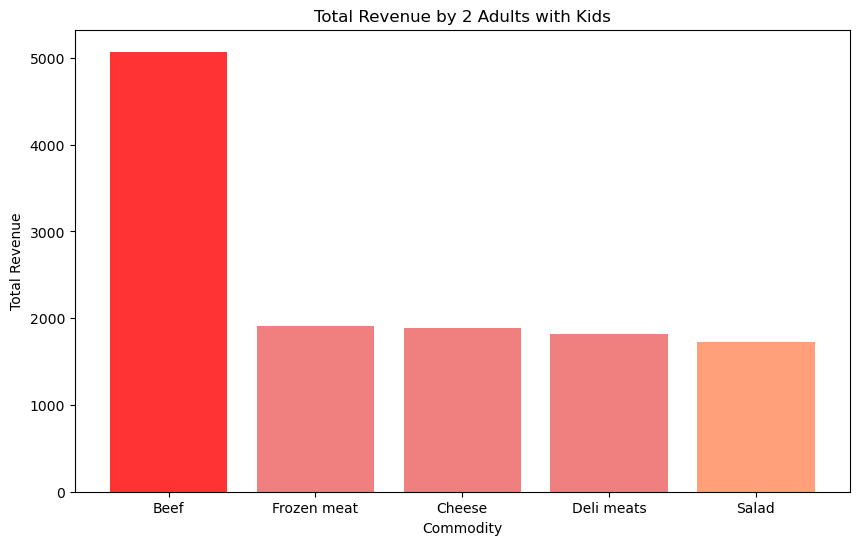

In [22]:
top_5_4 = twoadultskidsf.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

bar_colours = ['#FF3333', 'lightcoral', 'lightcoral', 'lightcoral', 'lightsalmon']

plt.figure(figsize=(10, 6))
plt.bar(top_5_4.index, top_5_4['Total_Revenue'], color=bar_colours)  
plt.title('Total Revenue by 2 Adults with Kids')  
plt.xlabel('Commodity')
plt.ylabel('Total Revenue')
plt.show()

#### Dividing the Table into Household_Type 2 adults with kids

In [23]:
oneadultskidsf = df[df["Household"] == "1 adult with kids"]

oneadultskidsf.head(100000)

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
0,15803,Loyalist,1 adult with kids,19-24,private,Baked bread/buns/rolls,0.99,5/10/2020
1,15803,Loyalist,1 adult with kids,19-24,national,Vegetables - all others,0.70,24/10/2020
2,15803,Loyalist,1 adult with kids,19-24,national,Cold and flu,1.68,18/10/2020
3,15803,Loyalist,1 adult with kids,19-24,private,Paper housewares,2.59,23/10/2020
4,15803,Loyalist,1 adult with kids,19-24,national,Soup,0.60,27/10/2020
...,...,...,...,...,...,...,...,...
77727,36986,Loyalist,1 adult with kids,35-44,private,Refrigerated,6.98,7/07/2020
77728,36986,Loyalist,1 adult with kids,35-44,national,Brooms and mops,2.49,7/07/2020
77729,36986,Loyalist,1 adult with kids,35-44,private,Halloween,15.98,23/07/2020
77730,36986,Loyalist,1 adult with kids,35-44,private,Laxatives,4.59,18/07/2020


In [24]:
oneadultskidsf.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

,Total_Revenue
Commodity,
Beef,4123.45
Cheese,1552.56
Deli meats,1489.57
Frozen meat,1488.57
Salad,1426.92


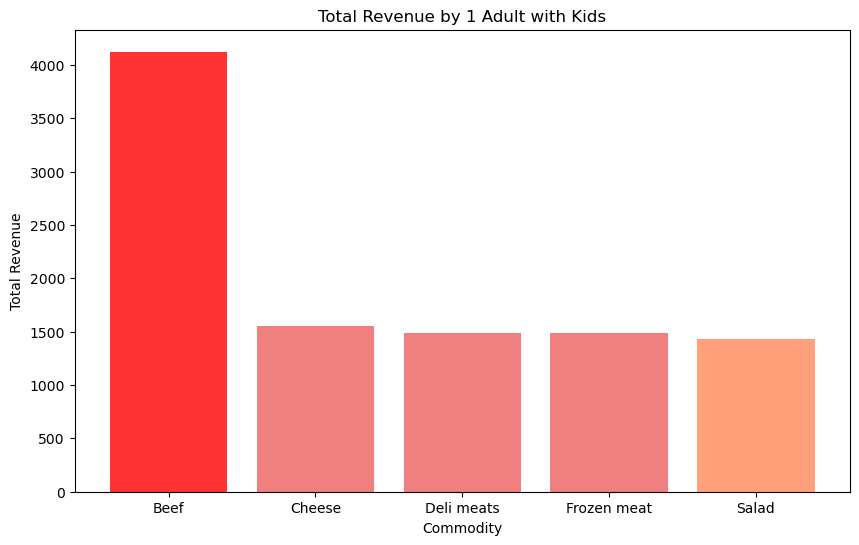

In [25]:
top_5_5 = oneadultskidsf.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

bar_colours = ['#FF3333', 'lightcoral', 'lightcoral', 'lightcoral', 'lightsalmon']

plt.figure(figsize=(10, 6))
plt.bar(top_5_5.index, top_5_5['Total_Revenue'], color=bar_colours)  
plt.title('Total Revenue by 1 Adult with Kids')  
plt.xlabel('Commodity')
plt.ylabel('Total Revenue')
plt.show()

## Top 5 Commodities amonst the Loyalty 

In [26]:
df.groupby(['Loyalty',]).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

,Total_Revenue
Loyalty,
Promiscuous,145365.55
Loyalist,102324.80
First Time Buyer,3524.53


In [28]:
tmp_1 = df.groupby(['Loyalty', 'Commodity']).agg(Total_Revenue=('Price', sum)).reset_index()
top_5_1 = pd.concat(
    [tmp_1[tmp_1.Loyalty==l] \
         .sort_values('Total_Revenue', ascending=False) \
     .head(5) for l in tmp_1.Loyalty.unique()]).reset_index(drop=True)

tmp_1.head(15)
top_5_1.head(15)


,Loyalty,Commodity,Total_Revenue
0,First Time Buyer,Beef,222.31
1,First Time Buyer,Frozen meat,97.96
2,First Time Buyer,Lunch meat,93.96
3,First Time Buyer,Seafood-frozen,86.98
4,First Time Buyer,Chicken,79.81
5,Loyalist,Beef,6894.34
6,Loyalist,Cheese,2531.60
7,Loyalist,Seafood-frozen,2469.48
8,Loyalist,Frozen meat,2444.80
9,Loyalist,Salad,2426.27


#### Dividing the Table into First Time Buyer


In [29]:
firstf = df[df["Loyalty"] == "First Time Buyer"]

firstf.head(100000)

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
115,15847,First Time Buyer,Single female,19-24,national,Pet care supplies,2.99,13/08/2021
116,15847,First Time Buyer,Single female,19-24,national,Frozen pizza,2.00,10/08/2021
117,15847,First Time Buyer,Single female,19-24,national,Soft drinks,4.19,10/08/2021
118,15847,First Time Buyer,Single female,19-24,national,Vegetables - all others,0.78,15/08/2021
119,15847,First Time Buyer,Single female,19-24,private,Organic fruit/vegetables,1.99,1/08/2021
...,...,...,...,...,...,...,...,...
77606,36818,First Time Buyer,1 adult with kids,45-54,national,Seasonal,3.99,16/07/2021
77607,36818,First Time Buyer,1 adult with kids,45-54,private,Bacon,2.99,30/07/2021
77608,36818,First Time Buyer,1 adult with kids,45-54,national,Candy,1.98,29/07/2021
77609,36818,First Time Buyer,1 adult with kids,45-54,national,Candles/accessories,1.30,7/07/2021


In [30]:
firstf.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

,Total_Revenue
Commodity,
Beef,222.31
Frozen meat,97.96
Lunch meat,93.96
Seafood-frozen,86.98
Chicken,79.81


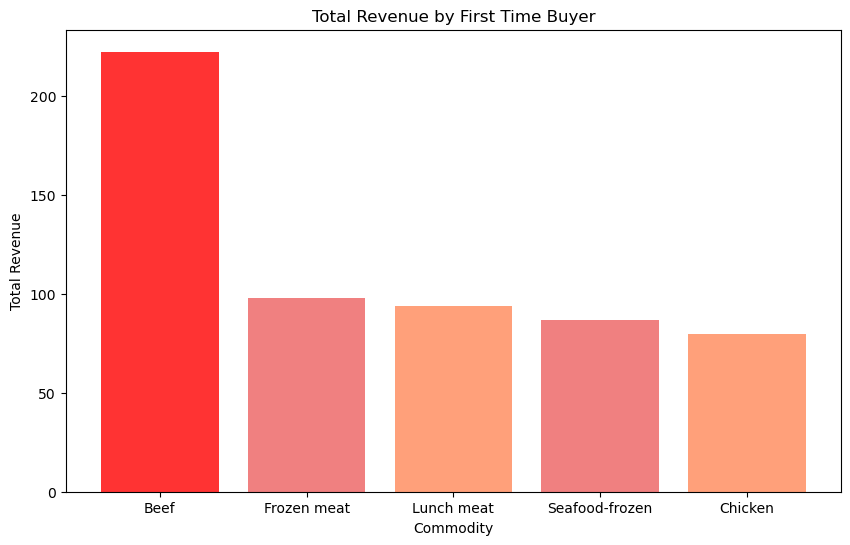

In [31]:
top_5_6=firstf.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

bar_colours = ['#FF3333', 'lightcoral', 'lightsalmon', 'lightcoral', 'lightsalmon']

plt.figure(figsize=(10, 6))
plt.bar(top_5_6.index, top_5_6['Total_Revenue'], color=bar_colours)  
plt.title('Total Revenue by First Time Buyer')  
plt.xlabel('Commodity')
plt.ylabel('Total Revenue')
plt.show()

#### Dividing the Table into Loyalist


In [32]:
loyalistf = df[df["Loyalty"] == "Loyalist"]

loyalistf.head(100000)

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
0,15803,Loyalist,1 adult with kids,19-24,private,Baked bread/buns/rolls,0.99,5/10/2020
1,15803,Loyalist,1 adult with kids,19-24,national,Vegetables - all others,0.70,24/10/2020
2,15803,Loyalist,1 adult with kids,19-24,national,Cold and flu,1.68,18/10/2020
3,15803,Loyalist,1 adult with kids,19-24,private,Paper housewares,2.59,23/10/2020
4,15803,Loyalist,1 adult with kids,19-24,national,Soup,0.60,27/10/2020
...,...,...,...,...,...,...,...,...
77727,36986,Loyalist,1 adult with kids,35-44,private,Refrigerated,6.98,7/07/2020
77728,36986,Loyalist,1 adult with kids,35-44,national,Brooms and mops,2.49,7/07/2020
77729,36986,Loyalist,1 adult with kids,35-44,private,Halloween,15.98,23/07/2020
77730,36986,Loyalist,1 adult with kids,35-44,private,Laxatives,4.59,18/07/2020


In [33]:
loyalistf.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

,Total_Revenue
Commodity,
Beef,6894.34
Cheese,2531.60
Seafood-frozen,2469.48
Frozen meat,2444.80
Salad,2426.27


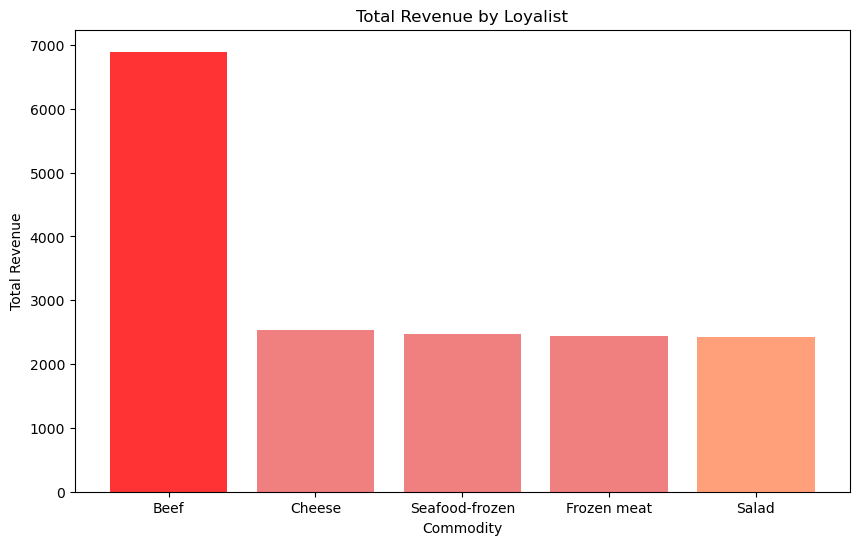

In [34]:
top_5_7=loyalistf.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

bar_colours = ['#FF3333', 'lightcoral', 'lightcoral', 'lightcoral', 'lightsalmon']

plt.figure(figsize=(10, 6))
plt.bar(top_5_7.index, top_5_7['Total_Revenue'], color=bar_colours)  
plt.title('Total Revenue by Loyalist')  
plt.xlabel('Commodity')
plt.ylabel('Total Revenue')
plt.show()

#### Dividing the Table into Promiscuous	


In [35]:
prof = df[df["Loyalty"] == "Promiscuous"]

prof.head(100000)

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
20,15811,Promiscuous,Single female,19-24,national,Water - carbonated/flavoured drinks,9.98,18/10/2021
21,15811,Promiscuous,Single female,19-24,national,Candy,0.89,11/10/2021
22,15811,Promiscuous,Single female,19-24,national,Makeup and treatment,1.25,13/10/2021
23,15811,Promiscuous,Single female,19-24,national,Dishwash detergents,3.49,1/10/2021
24,15811,Promiscuous,Single female,19-24,national,Soft drinks,1.29,1/10/2021
...,...,...,...,...,...,...,...,...
77745,36987,Promiscuous,2 adults with kids,45-54,national,Vegetables - all others,0.79,14/07/2020
77746,36987,Promiscuous,2 adults with kids,45-54,national,Lunch meat,3.00,24/07/2020
77747,36987,Promiscuous,2 adults with kids,45-54,private,Onions,1.99,3/07/2020
77748,36987,Promiscuous,2 adults with kids,45-54,national,Beef,4.92,6/07/2020


In [36]:
prof.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

,Total_Revenue
Commodity,
Beef,10201.31
Cheese,3769.01
Frozen meat,3701.51
Deli meats,3479.16
Salad,3229.22


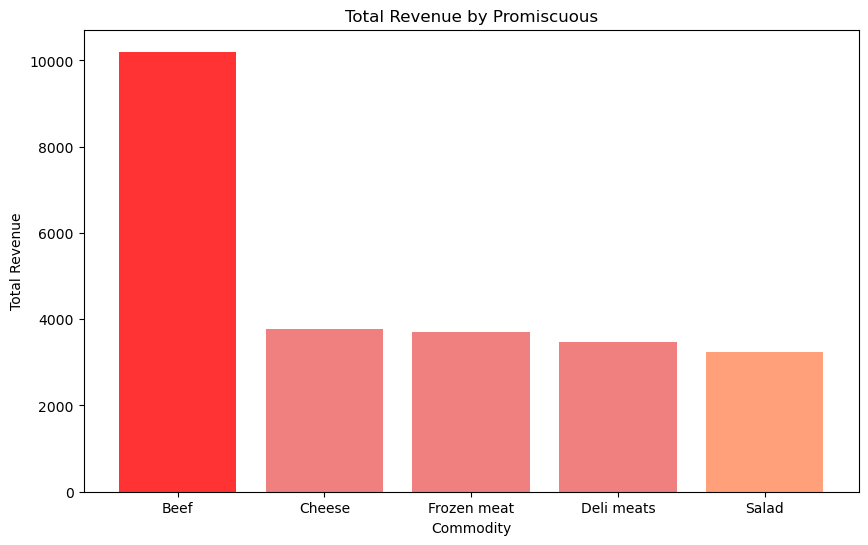

In [37]:
top_5_8=prof.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

bar_colours = ['#FF3333', 'lightcoral', 'lightcoral', 'lightcoral', 'lightsalmon']

plt.figure(figsize=(10, 6))
plt.bar(top_5_8.index, top_5_8['Total_Revenue'], color=bar_colours)  
plt.title('Total Revenue by Promiscuous')  
plt.xlabel('Commodity')
plt.ylabel('Total Revenue')
plt.show()

## Top 5 Commodities amonst Age Groups 

In [38]:
ta = df.groupby('Age').agg(Revenue=('Price', sum)).reset_index()
ta

,Age,Revenue
0,19-24,129514.46
1,25-34,41374.53
2,35-44,15307.18
3,45-54,64142.33
4,55-64,450.64
5,Greater than 65,425.74


Text(0, 0.5, 'Total Revenue')

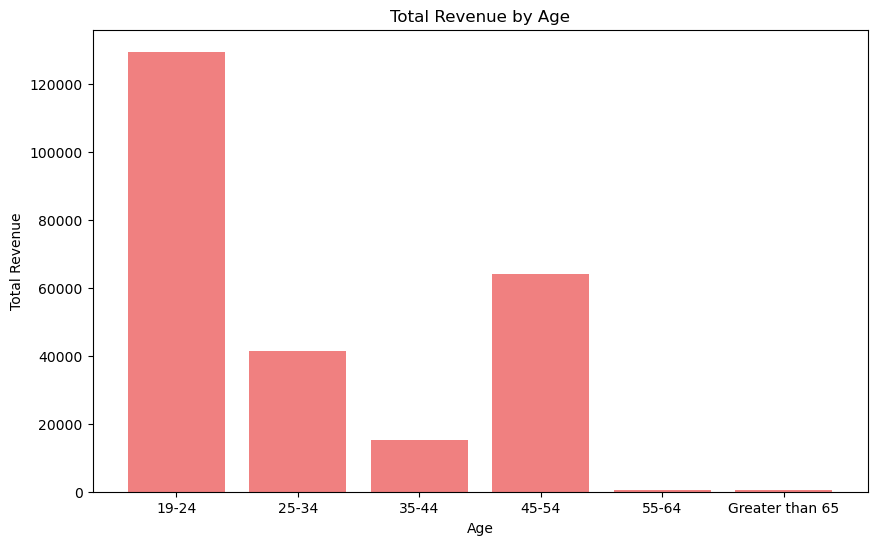

In [39]:
ta = df.groupby('Age').agg(Revenue=('Price', sum)).reset_index()
plt.figure(figsize=(10, 6))
plt.bar(ta['Age'], ta['Revenue'], color='lightcoral')  
plt.title('Total Revenue by Age')
plt.xlabel('Age')
plt.ylabel('Total Revenue')

In [40]:
tmp_2=df.groupby(['Age', 'Commodity']).agg(Total_Revenue=('Price', sum)).reset_index()
top_5_2 = pd.concat(
    [tmp_2[tmp_2.Age==l] \
         .sort_values('Total_Revenue', ascending=False) \
     .head(5) for l in tmp_2.Age.unique()]).reset_index(drop=True)

tmp_2.head(30)
top_5_2.head(30)

,Age,Commodity,Total_Revenue
0,19-24,Beef,9134.00
1,19-24,Seafood-frozen,4139.20
2,19-24,Cheese,3260.77
3,19-24,Frozen meat,3192.62
4,19-24,Deli meats,3015.74
5,25-34,Beef,2710.86
6,25-34,Cheese,1106.76
7,25-34,Seafood-frozen,1060.70
8,25-34,Salad,976.23
9,25-34,Frozen meat,973.70


In [41]:
af = df[df["Age"] == "19-24"]

af.head(100000)

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
0,15803,Loyalist,1 adult with kids,19-24,private,Baked bread/buns/rolls,0.99,5/10/2020
1,15803,Loyalist,1 adult with kids,19-24,national,Vegetables - all others,0.70,24/10/2020
2,15803,Loyalist,1 adult with kids,19-24,national,Cold and flu,1.68,18/10/2020
3,15803,Loyalist,1 adult with kids,19-24,private,Paper housewares,2.59,23/10/2020
4,15803,Loyalist,1 adult with kids,19-24,national,Soup,0.60,27/10/2020
...,...,...,...,...,...,...,...,...
77698,36929,Promiscuous,Single female,19-24,national,Oral hygiene products,2.99,31/07/2021
77699,36929,Promiscuous,Single female,19-24,national,Candy,0.50,13/07/2021
77700,36929,Promiscuous,Single female,19-24,national,Rolls,1.29,1/07/2021
77701,36929,Promiscuous,Single female,19-24,national,Rolls,0.34,1/07/2021


In [42]:
af.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

,Total_Revenue
Commodity,
Beef,9134.00
Seafood-frozen,4139.20
Cheese,3260.77
Frozen meat,3192.62
Deli meats,3015.74


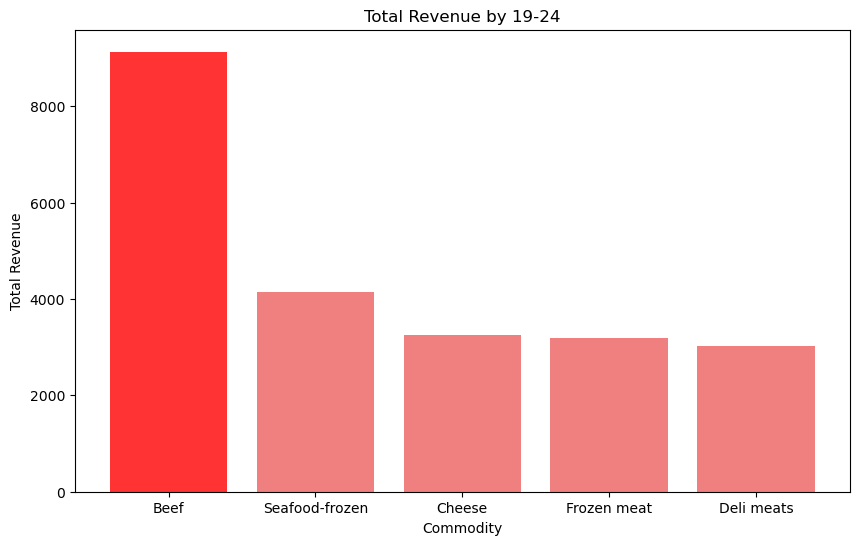

In [43]:
top_5_9=af.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

bar_colours = ['#FF3333', 'lightcoral', 'lightcoral', 'lightcoral', 'lightcoral']

plt.figure(figsize=(10, 6))
plt.bar(top_5_9.index, top_5_9['Total_Revenue'], color=bar_colours)  
plt.title('Total Revenue by 19-24')  
plt.xlabel('Commodity')
plt.ylabel('Total Revenue')
plt.show()

In [44]:
bf = df[df["Age"] == "25-34"]

bf.head(100000)

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
84,15820,Loyalist,2 adults with kids,25-34,private,Flour,1.12,28/08/2021
85,15820,Loyalist,2 adults with kids,25-34,private,Vegetables - shelf stable,0.88,13/08/2021
86,15820,Loyalist,2 adults with kids,25-34,national,Coffee,4.29,14/08/2021
87,15820,Loyalist,2 adults with kids,25-34,national,Bath tissues,5.99,2/08/2021
88,15820,Loyalist,2 adults with kids,25-34,private,Paper towels,2.00,9/08/2021
...,...,...,...,...,...,...,...,...
77301,36569,Loyalist,1 adult with kids,25-34,national,Tropical fruit,1.11,31/07/2020
77302,36569,Loyalist,1 adult with kids,25-34,national,Salad,5.67,26/07/2020
77303,36569,Loyalist,1 adult with kids,25-34,national,Chicken,2.55,4/07/2020
77304,36569,Loyalist,1 adult with kids,25-34,national,Cigarettes,20.69,30/07/2020


In [45]:
bf.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

,Total_Revenue
Commodity,
Beef,2710.86
Cheese,1106.76
Seafood-frozen,1060.70
Salad,976.23
Frozen meat,973.70


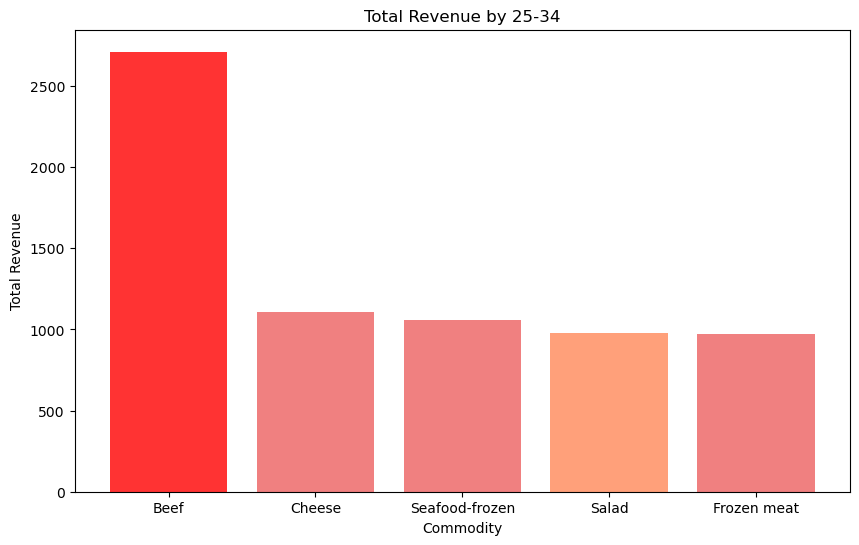

In [46]:
top_5_10=bf.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

bar_colours = ['#FF3333', 'lightcoral', 'lightcoral', 'lightsalmon', 'lightcoral']

plt.figure(figsize=(10, 6))
plt.bar(top_5_10.index, top_5_10['Total_Revenue'], color=bar_colours)  
plt.title('Total Revenue by 25-34')  
plt.xlabel('Commodity')
plt.ylabel('Total Revenue')
plt.show()

In [47]:
cf = df[df["Age"] == "35-44"]

cf.head(100000)

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
98,15822,Loyalist,1 adult with kids,35-44,national,Fitness/diet,1.00,31/08/2021
99,15822,Loyalist,1 adult with kids,35-44,private,Ice cream/milk/sherbets,3.00,13/08/2021
100,15822,Loyalist,1 adult with kids,35-44,private,Powder/crystal drink mix,3.59,9/08/2021
101,15822,Loyalist,1 adult with kids,35-44,national,Imported wine,7.99,20/08/2021
102,15822,Loyalist,1 adult with kids,35-44,national,Floral accessories,1.49,31/08/2021
...,...,...,...,...,...,...,...,...
77727,36986,Loyalist,1 adult with kids,35-44,private,Refrigerated,6.98,7/07/2020
77728,36986,Loyalist,1 adult with kids,35-44,national,Brooms and mops,2.49,7/07/2020
77729,36986,Loyalist,1 adult with kids,35-44,private,Halloween,15.98,23/07/2020
77730,36986,Loyalist,1 adult with kids,35-44,private,Laxatives,4.59,18/07/2020


In [48]:
cf.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

,Total_Revenue
Commodity,
Beef,946.82
Pork,441.82
Salad,407.77
Lunch meat,389.96
Deli meats,351.09


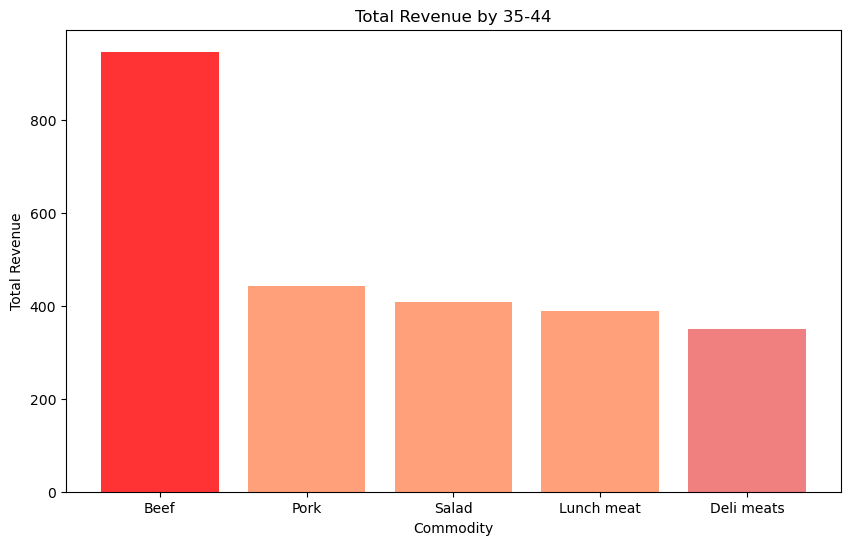

In [49]:
top_5_11=cf.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

bar_colours = ['#FF3333', 'lightsalmon', 'lightsalmon', 'lightsalmon', 'lightcoral']

plt.figure(figsize=(10, 6))
plt.bar(top_5_11.index, top_5_11['Total_Revenue'], color=bar_colours)  
plt.title('Total Revenue by 35-44')  
plt.xlabel('Commodity')
plt.ylabel('Total Revenue')
plt.show()

In [50]:
ef = df[df["Age"] == "45-54"]

ef.head(100000)

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
147,15853,Promiscuous,2 adults with kids,45-54,national,Hot dogs,2.19,27/09/2019
148,15853,Promiscuous,2 adults with kids,45-54,national,Vegetables - shelf stable,1.19,27/09/2019
149,15853,Promiscuous,2 adults with kids,45-54,national,Potatoes,0.69,14/09/2019
150,15853,Promiscuous,2 adults with kids,45-54,national,Soup,1.59,2/09/2019
151,15853,Promiscuous,2 adults with kids,45-54,national,Facial tissues,1.49,3/09/2019
...,...,...,...,...,...,...,...,...
77745,36987,Promiscuous,2 adults with kids,45-54,national,Vegetables - all others,0.79,14/07/2020
77746,36987,Promiscuous,2 adults with kids,45-54,national,Lunch meat,3.00,24/07/2020
77747,36987,Promiscuous,2 adults with kids,45-54,private,Onions,1.99,3/07/2020
77748,36987,Promiscuous,2 adults with kids,45-54,national,Beef,4.92,6/07/2020


In [51]:
ef.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

,Total_Revenue
Commodity,
Beef,4483.38
Frozen meat,1748.35
Cheese,1679.31
Deli meats,1570.94
Salad,1473.72


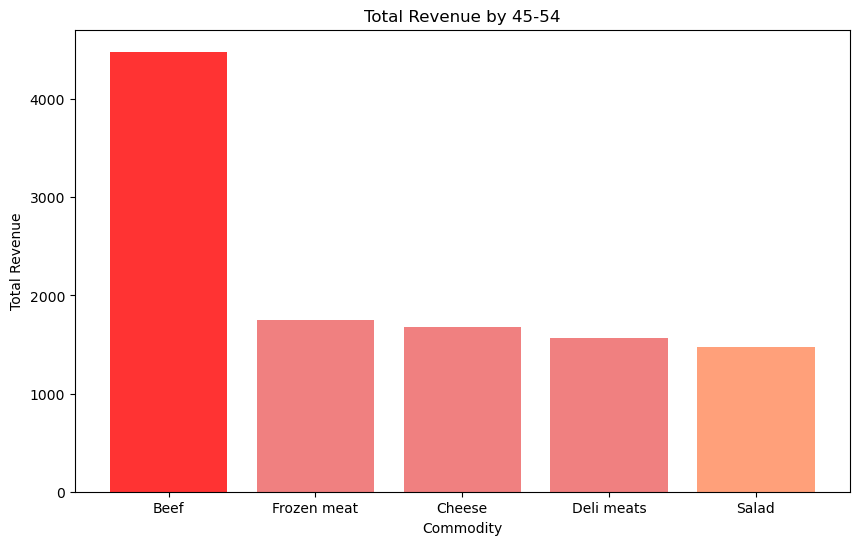

In [52]:
top_5_12=ef.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
    .sort_values('Total_Revenue', ascending = False).head(5)

bar_colours = ['#FF3333', 'lightcoral', 'lightcoral', 'lightcoral', 'lightsalmon']

plt.figure(figsize=(10, 6))
plt.bar(top_5_12.index, top_5_12['Total_Revenue'], color=bar_colours)  
plt.title('Total Revenue by 45-54')  
plt.xlabel('Commodity')
plt.ylabel('Total Revenue')
plt.show()

#### Will not use 55-64 and greater than 65 as revenue is very small 

In [698]:
# ff = df[df["Age"] == "55-64"]

# ff.head(100000)

In [699]:
# ff.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
#     .sort_values('Total_Revenue', ascending = False).head(5)

In [700]:
# top_5_13=ff.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
#     .sort_values('Total_Revenue', ascending = False).head(5)

# bar_colours = ['#e1e1e1', 'skyblue', '#e1e1e1', '#e1e1e1', '#e1e1e1']

# fig = go.Figure(data=[go.Bar(x=top_5_13.index, y=top_5_13['Total_Revenue'], marker_color=bar_colours)])

# fig.update_layout(
#     title='Top 5 Commodities 55-64',
#     xaxis=dict(title='Commodity'),
#     yaxis=dict(title='Total Revenue'),
# )

# fig.show(renderer='iframe')

In [701]:
# gf = df[df["Age"] == "Greater than 65"]

# gf.head(100000)

In [702]:
# gf.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
#     .sort_values('Total_Revenue', ascending = False).head(5)

In [380]:
# top_5_14=gf.groupby(['Commodity']).agg(Total_Revenue=('Price',sum)) \
#     .sort_values('Total_Revenue', ascending = False).head(5)

# bar_colours = ['#e1e1e1', '#e1e1e1','skyblue', '#e1e1e1', '#e1e1e1']

# fig = go.Figure(data=[go.Bar(x=top_5_14.index, y=top_5_14['Total_Revenue'], marker_color=bar_colours)])

# fig.update_layout(
#     title='Top 5 Commodities 55-64',
#     xaxis=dict(title='Commodity'),
#     yaxis=dict(title='Total Revenue'),
# )

# fig.show(renderer='iframe')

# Brand Preference
Do customers have a brand preference

In [53]:
brand_counts = df['Brand'].value_counts().reset_index()
brand_counts.columns = ['Brand', 'Count']

brand_counts

,Brand,Count
0,national,59884
1,private,17866


In [54]:
brand_counts = df['Brand'].value_counts().reset_index()
brand_counts.columns = ['Brand', 'Count']


colors = ['lightsalmon', '#fedc97']
hole_size = 0.7 

fig = go.Figure(
    data=[go.Pie(labels=brand_counts['Brand'], values=brand_counts['Count'], marker=dict(colors=colors), hole=hole_size)]
)
fig.update_layout(title_text='Brand Distribution ')
fig.show(renderer="notebook")

In [55]:
df_beef = df[df['Commodity'] == 'Beef'] 

df_beef

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
16,15803,Loyalist,1 adult with kids,19-24,national,Beef,2.54,28/10/2020
32,15811,Promiscuous,Single female,19-24,national,Beef,3.82,24/10/2021
55,15815,Loyalist,Single female,19-24,national,Beef,7.99,15/08/2021
78,15818,Loyalist,2 adults with no kids,19-24,national,Beef,6.13,23/12/2019
81,15818,Loyalist,2 adults with no kids,19-24,national,Beef,1.26,2/12/2019
...,...,...,...,...,...,...,...,...
77693,36929,Promiscuous,Single female,19-24,national,Beef,3.91,3/07/2021
77695,36929,Promiscuous,Single female,19-24,national,Beef,4.19,17/07/2021
77704,36986,Loyalist,1 adult with kids,35-44,national,Beef,3.69,21/07/2020
77706,36986,Loyalist,1 adult with kids,35-44,national,Beef,1.22,1/07/2020


In [56]:
df_beef['Brand'].value_counts().reset_index()

,Brand,count
0,national,2778
1,private,166


In [57]:
Piechart = df_beef['Brand'].value_counts().reset_index()
Piechart.columns = ['Brand', 'Count']

colors = ['lightsalmon', '#fedc97']
hole_size = 0.7 

fig = go.Figure(
    data=[go.Pie(labels=Piechart['Brand'], values=Piechart['Count'], marker=dict(colors=colors), hole=hole_size)]
)
fig.update_layout(title_text='Brand Distribution Beef')
fig.show(renderer="notebook")

In [58]:
df_cheese = df[df['Commodity'] == 'Cheese'] 

df_cheese

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
46,15815,Loyalist,Single female,19-24,private,Cheese,5.00,19/08/2021
49,15815,Loyalist,Single female,19-24,private,Cheese,1.50,12/08/2021
70,15818,Loyalist,2 adults with no kids,19-24,private,Cheese,2.99,3/12/2019
105,15822,Loyalist,1 adult with kids,35-44,private,Cheese,2.99,17/08/2021
181,15856,Promiscuous,Single female,19-24,private,Cheese,2.00,10/12/2019
...,...,...,...,...,...,...,...,...
77642,36859,Promiscuous,2 adults with kids,45-54,private,Cheese,2.50,15/07/2021
77647,36859,Promiscuous,2 adults with kids,45-54,national,Cheese,2.50,19/07/2021
77692,36929,Promiscuous,Single female,19-24,national,Cheese,3.89,17/07/2021
77716,36986,Loyalist,1 adult with kids,35-44,national,Cheese,1.00,6/07/2020


In [59]:
df_cheese['Brand'].value_counts().reset_index()

,Brand,count
0,national,1177
1,private,886


In [60]:
Piechart_1 = df_cheese['Brand'].value_counts().reset_index()
Piechart_1.columns = ['Brand', 'Count']

colors = ['lightsalmon', '#fedc97']
hole_size = 0.7 

fig = go.Figure(
    data=[go.Pie(labels=Piechart_1['Brand'], values=Piechart_1['Count'], marker=dict(colors=colors), hole=hole_size)]
)
fig.update_layout(title_text='Brand Distribution Cheese')
fig.show(renderer="notebook")

In [61]:
df_fm = df[df['Commodity'] == 'Frozen meat'] 

df_fm

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
80,15818,Loyalist,2 adults with no kids,19-24,national,Frozen meat,3.58,21/12/2019
159,15855,Loyalist,Single male,19-24,national,Frozen meat,2.00,28/10/2021
182,15856,Promiscuous,Single female,19-24,national,Frozen meat,2.50,18/12/2019
201,15856,Promiscuous,Single female,19-24,national,Frozen meat,1.67,24/12/2019
230,15861,Loyalist,Single male,19-24,national,Frozen meat,3.50,30/12/2020
...,...,...,...,...,...,...,...,...
77478,36693,Promiscuous,2 adults with kids,45-54,national,Frozen meat,0.88,18/06/2021
77500,36785,Loyalist,1 adult with kids,45-54,national,Frozen meat,3.50,18/07/2020
77521,36792,Loyalist,2 adults with no kids,19-24,national,Frozen meat,1.67,9/07/2021
77538,36799,Loyalist,2 adults with kids,19-24,national,Frozen meat,1.67,29/07/2020


In [62]:
df_fm['Brand'].value_counts().reset_index()

,Brand,count
0,national,1441
1,private,148


In [63]:
Piechart_2 = df_fm['Brand'].value_counts().reset_index()
Piechart_2.columns = ['Brand', 'Count']

colors = ['lightsalmon', '#fedc97']
hole_size = 0.7

fig = go.Figure(
    data=[go.Pie(labels=Piechart_2['Brand'], values=Piechart_2['Count'], marker=dict(colors=colors), hole=hole_size)]
)
fig.update_layout(title_text='Brand Distribution Frozen Meats')
fig.show(renderer="notebook")

In [64]:
df_dm = df[df['Commodity'] == 'Deli meats'] 

df_dm

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
9,15803,Loyalist,1 adult with kids,19-24,national,Deli meats,3.17,24/10/2020
82,15818,Loyalist,2 adults with no kids,19-24,national,Deli meats,3.11,21/12/2019
109,15822,Loyalist,1 adult with kids,35-44,national,Deli meats,5.14,5/08/2021
167,15855,Loyalist,Single male,19-24,national,Deli meats,1.44,14/10/2021
170,15855,Loyalist,Single male,19-24,national,Deli meats,2.88,21/10/2021
...,...,...,...,...,...,...,...,...
77410,36651,Promiscuous,Single male,19-24,national,Deli meats,4.58,28/06/2021
77672,36903,Loyalist,1 adult with kids,35-44,national,Deli meats,7.29,28/07/2021
77719,36986,Loyalist,1 adult with kids,35-44,national,Deli meats,1.95,27/07/2020
77720,36986,Loyalist,1 adult with kids,35-44,national,Deli meats,5.17,6/07/2020


In [65]:
df_dm['Brand'].value_counts().reset_index()

,Brand,count
0,national,1523
1,private,8


In [66]:
Piechart_3 = df_dm['Brand'].value_counts().reset_index()
Piechart_3.columns = ['Brand', 'Count']

colors = ['lightsalmon', '#fedc97']
hole_size = 0.7

fig = go.Figure(
    data=[go.Pie(labels=Piechart_3['Brand'], values=Piechart_3['Count'], marker=dict(colors=colors), hole=hole_size)]
)
fig.update_layout(title_text='Brand Distribution Deli Meats')
fig.show(renderer="notebook")

In [67]:
df_sfm = df[df['Commodity'] == 'Seafood-frozen'] 

df_sfm

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
15,15803,Loyalist,1 adult with kids,19-24,national,Seafood-frozen,2.50,13/10/2020
124,15847,First Time Buyer,Single female,19-24,national,Seafood-frozen,5.00,18/08/2021
174,15855,Loyalist,Single male,19-24,national,Seafood-frozen,2.50,10/10/2021
602,15920,Loyalist,2 adults with no kids,19-24,national,Seafood-frozen,9.78,21/09/2021
627,15923,Promiscuous,Single female,25-34,private,Seafood-frozen,6.99,7/08/2019
...,...,...,...,...,...,...,...,...
77280,36564,Promiscuous,2 adults with no kids,19-24,national,Seafood-frozen,3.99,16/06/2021
77386,36641,Promiscuous,2 adults with no kids,19-24,private,Seafood-frozen,6.99,6/06/2021
77533,36792,Loyalist,2 adults with no kids,19-24,national,Seafood-frozen,4.99,3/07/2021
77560,36799,Loyalist,2 adults with kids,19-24,national,Seafood-frozen,2.44,13/07/2020


In [68]:
df_sfm['Brand'].value_counts().reset_index()

,Brand,count
0,private,528
1,national,344


In [69]:
Piechart_4 = df_sfm['Brand'].value_counts().reset_index()
Piechart_4.columns = ['Brand', 'Count']

colors = [ '#fedc97', 'lightsalmon']
hole_size = 0.7 

fig = go.Figure(
    data=[go.Pie(labels=Piechart_4['Brand'], values=Piechart_4['Count'], marker=dict(colors=colors), hole=hole_size)]
)
fig.update_layout(title_text='Brand Distribution Seafood_Frozen')
fig.show(renderer="notebook")

# Seasonal Trends 

In [70]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 77750 entries, 0 to 77749
Data columns (total 8 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Customer   77750 non-null  int64  
 1   Loyalty    77750 non-null  object 
 2   Household  77750 non-null  object 
 3   Age        77750 non-null  object 
 4   Brand      77750 non-null  object 
 5   Commodity  77750 non-null  object 
 6   Price      77750 non-null  float64
 7   Date       77750 non-null  object 
dtypes: float64(1), int64(1), object(6)
memory usage: 4.7+ MB


In [71]:
df.head(5)

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
0,15803,Loyalist,1 adult with kids,19-24,private,Baked bread/buns/rolls,0.99,5/10/2020
1,15803,Loyalist,1 adult with kids,19-24,national,Vegetables - all others,0.70,24/10/2020
2,15803,Loyalist,1 adult with kids,19-24,national,Cold and flu,1.68,18/10/2020
3,15803,Loyalist,1 adult with kids,19-24,private,Paper housewares,2.59,23/10/2020
4,15803,Loyalist,1 adult with kids,19-24,national,Soup,0.60,27/10/2020


In [72]:
df_trend = df.sort_values('Date', ascending = True)

df_trend["Date"] = pd.to_datetime(df["Date"], errors='coerce')

df_trend.sort_values('Date', inplace=True)

df_trend

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
31749,22405,Promiscuous,Single male,25-34,national,Hair care products,5.99,2019-01-01
37006,23087,Promiscuous,Single male,25-34,national,Potatoes,11.64,2019-01-01
30769,22276,Promiscuous,2 adults with kids,45-54,national,Breakfast sausage/sandwiches,5.00,2019-01-01
55299,26413,Promiscuous,Single female,25-34,national,Hand/body/facial products,5.95,2019-01-01
50468,25491,Promiscuous,2 adults with no kids,19-24,national,Baby hbc,6.49,2019-01-01
...,...,...,...,...,...,...,...,...
10724,17781,Promiscuous,Single female,19-24,national,Pork,3.64,NaT
23460,20602,Promiscuous,1 adult with kids,19-24,national,Warehouse snacks,1.09,NaT
7827,17255,Promiscuous,2 adults with no kids,19-24,private,Cookies,2.00,NaT
6464,16960,Promiscuous,1 adult with kids,25-34,national,Cold and flu,3.99,NaT


In [80]:
df_trend = df.copy() 

df_trend.sort_values('Date', inplace=True)

df["Date"] = pd.to_datetime(df["Date"], errors='coerce')

df['Date'].fillna(df_trend['Date'], inplace=True)

df.dropna(subset=['Date'], inplace=True)

df.sort_values('Date', inplace=True)\

df_trend

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
37001,23087,Promiscuous,Single male,25-34,national,Crackers/misc bkd fd,2.00,2019-01-01
61881,27662,Loyalist,Single male,19-24,national,Citrus,1.20,2019-01-01
61878,27662,Loyalist,Single male,19-24,national,Bag snacks,2.49,2019-01-01
30747,22276,Promiscuous,2 adults with kids,45-54,national,Chicken,4.13,2019-01-01
56335,26599,Loyalist,2 adults with no kids,19-24,national,Disposible foilware,2.99,2019-01-01
...,...,...,...,...,...,...,...,...
57476,26800,Loyalist,2 adults with no kids,19-24,national,Baked bread/buns/rolls,2.50,2022-12-05
44489,24393,Promiscuous,1 adult with kids,19-24,national,Cheese,5.49,2022-12-05
56875,26703,Promiscuous,2 adults with kids,45-54,national,Bleach,1.79,2022-12-05
48495,25082,Loyalist,1 adult with kids,19-24,national,Frozen meat,3.29,2022-12-05


In [83]:
df_trend.info()

<class 'pandas.core.frame.DataFrame'>
Index: 77750 entries, 37001 to 61363
Data columns (total 8 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   Customer   77750 non-null  int64         
 1   Loyalty    77750 non-null  object        
 2   Household  77750 non-null  object        
 3   Age        77750 non-null  object        
 4   Brand      77750 non-null  object        
 5   Commodity  77750 non-null  object        
 6   Price      77750 non-null  float64       
 7   Date       77750 non-null  datetime64[ns]
dtypes: datetime64[ns](1), float64(1), int64(1), object(5)
memory usage: 7.4+ MB


In [82]:
# import pandas as pd
# from pandas.plotting import autocorrelation_plot
# import numpy as np
# import matplotlib.pyplot as plt
# from statsmodels.tsa.seasonal import seasonal_decompose #library for time series analysis
# from statsmodels.tsa.stattools import adfuller
# from statsmodels.tsa.arima_model import ARIMA
# import statsmodels
# statsmodels.__version__

In [521]:
# df_trend['Date'] = df.Date + pd.offsets.MonthBegin(-1)
# df_trend['Date'] = pd.to_datetime(df.Date)

# df_trend

In [522]:
# topfive = df_trend[df_trend.Commodity.str.lower().str.contains('beef|cheese|frozen meat|deli meats')].copy()

# topfive

In [523]:
# ts = topfive.groupby(['Date']).agg(total_revenue=('Price', sum)).reset_index()
# ts

In [524]:
# training = ts.loc[ts.Date < '2022-01-01'].set_index('Date')
# training.shape

In [525]:
# training.plot(color='lightcoral')

In [526]:
# ts_components = seasonal_decompose(training)
# ts_components.plot();


In [527]:
# split = round(len(training) / 2)
# x1 = training[0:split]
# x2 = training[split:]
# mean1= x1.mean()
# mean2= x2.mean()
# print("Mean 1 & 2= ", mean1[0], mean2[0])
# var1=x1.var()
# var2=x2.var()
# print("Variance 1 & 2= ",var1[0], var2[0])

In [528]:
# test_adf = adfuller(training)

In [529]:
# print('ADF test = ', test_adf[0])
# print('p-value = ', test_adf[1])


Given that the ADF value is negative and p-value < 0.05, we can reject the null hyphotesis and tell that our time series is stationary. Now we can apply a forecasting method.

In [530]:
# autocorrelation_plot(training);

In [531]:
# test = ts.loc[ts.Date >= '2022-01-01'].set_index('Date')
# test.head(10000)

In [532]:
# import pandas as pd
# from statsmodels.tsa.arima.model import ARIMA


# whole = ts.set_index('Date').squeeze().copy()

# history = whole.take(range(36))

# future = test.squeeze().copy()
# for t in range(len(future)):
    
#     model = ARIMA(history, order=(6,0,0), freq='MS')
    
#     model_fit = model.fit(1)
   
#     output = model_fit.forecast(steps=1)
    
#     yhat = output[0]
   
#     obs = future[t]

#     print('prediction', yhat, ', expected', obs)
    
#     history = pd.concat([history, pd.Series([obs], index=[future.index[t]])])

This error kept occuring for the above code

In [ ]:
# C:\Anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

# No frequency information was provided, so inferred frequency MS will be used.

# ---------------------------------------------------------------------------
# IndexError                                Traceback (most recent call last)
# Cell In[512], line 14
#      10 for t in range(len(future)):
#      12     model = ARIMA(history, order=(6,0,0), freq='MS')
# ---> 14     model_fit = model.fit(1)
#      16     output = model_fit.forecast(steps=1)
#      18     yhat = output[0]

# File C:\Anaconda3\Lib\site-packages\statsmodels\tsa\arima\model.py:395, in ARIMA.fit(self, start_params, transformed, includes_fixed, method, method_kwargs, gls, gls_kwargs, cov_type, cov_kwds, return_params, low_memory)
#     392 else:
#     393     method_kwargs.setdefault('disp', 0)
# --> 395     res = super().fit(
#     396         return_params=return_params, low_memory=low_memory,
#     397         cov_type=cov_type, cov_kwds=cov_kwds, **method_kwargs)
#     398     if not return_params:
#     399         res.fit_details = res.mlefit

# File C:\Anaconda3\Lib\site-packages\statsmodels\tsa\statespace\mlemodel.py:674, in MLEModel.fit(self, start_params, transformed, includes_fixed, cov_type, cov_kwds, method, maxiter, full_output, disp, callback, return_params, optim_score, optim_complex_step, optim_hessian, flags, low_memory, **kwargs)
#     672 # Unconstrain the starting parameters
#     673 if transformed:
# --> 674     start_params = self.untransform_params(start_params)
#     676 # Remove any fixed parameters
#     677 if self._has_fixed_params:

# File C:\Anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:1485, in SARIMAX.untransform_params(self, constrained)
#    1483     end += 1
#    1484 if self.state_error and not self.concentrate_scale:
# -> 1485     unconstrained[start] = constrained[start]**0.5
#    1486     # start += 1
#    1487     # end += 1
#    1489 return unconstrained

# IndexError: index 7 is out of bounds for axis 0 with size 1

# TREND

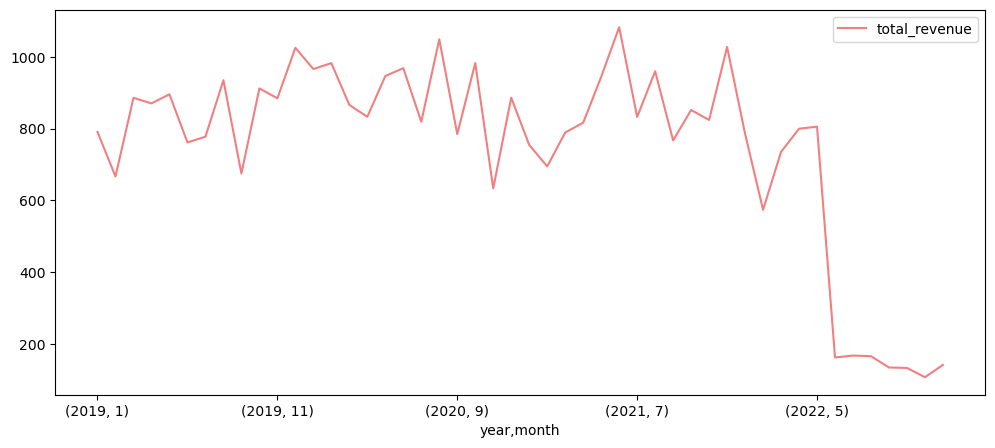

In [84]:
topfive = df_trend[df_trend.Commodity.str.lower().str.contains('beef|cheese|frozen meat|deli meats')].copy()
topfive.Date = pd.to_datetime(topfive.Date, format='%d-%m-%Y')
topfive['year'] = topfive.Date.dt.year
topfive['month'] = topfive.Date.dt.month
topfive.groupby(['year', 'month']).agg(total_revenue=('Price', sum)).plot(figsize=(12,5), color='lightcoral');

In [85]:
topfive = df_trend[df_trend.Commodity.str.lower().str.contains('beef|cheese|frozen meat|deli meats|seafood-frozen')].copy()
topfive.Date = pd.to_datetime(topfive.Date, format='%Y-%m-%d')
topfive['year_month'] = topfive.Date.dt.to_period('M')
topfive['Date'] = df.Date + pd.offsets.MonthBegin(-1)

topfive.groupby(['Commodity', 'year_month']).agg(total_revenue=('Price', sum)).unstack('Commodity').head(5)

total_revenue                                              
Commodity           Beef  Cheese Deli meats Frozen meat Seafood-frozen
year_month                                                            
2019-01           407.97  102.16      77.00      203.48         174.94
2019-02           355.26   94.73     129.00       87.60         229.10
2019-03           374.72  255.29     135.47      120.25         223.87
2019-04           420.15  184.06     114.77      151.22          80.80
2019-05           496.74  134.00     128.17      136.62         124.05

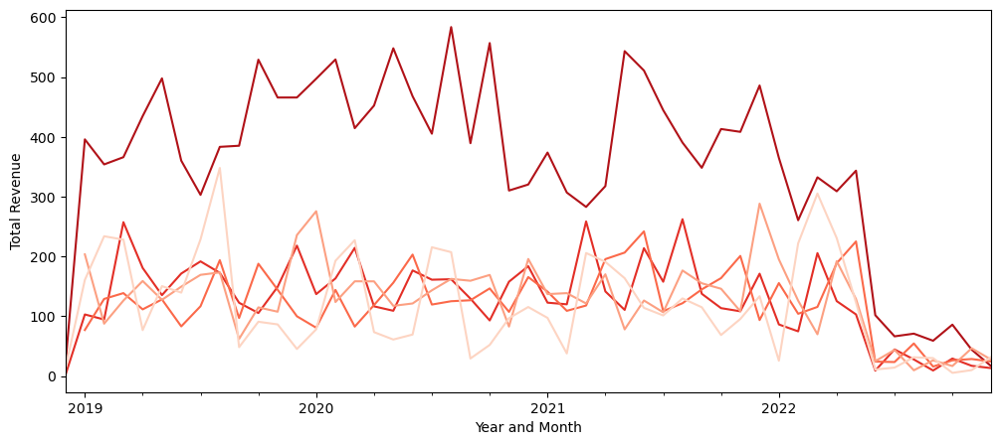

In [86]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

topfive = df_trend[df_trend.Commodity.str.lower().str.contains('beef|cheese|frozen meat|deli meats|seafood-frozen')].copy()
topfive['Date'] = pd.to_datetime(topfive['Date'], format='%Y-%m-%d')
topfive['Date'] = topfive['Date'] + pd.offsets.MonthBegin(-1)

topfive['year_month'] = topfive['Date'].dt.to_period('M')

palette = sns.color_palette("Reds", n_colors=len(topfive['Commodity'].unique()))[::-1]

ax = topfive.groupby(['Commodity', 'year_month']).agg(total_revenue=('Price', sum)).unstack('Commodity').plot(figsize=(12, 5), color=palette)

ax.set_xlabel('Year and Month')
ax.set_ylabel('Total Revenue')
ax.legend().set_visible(False)

plt.show()

In [87]:
df_trend_1 = df_trend.loc[(df_trend['Date'] >= '2019-01-01') & (df_trend['Date'] <= '2019-12-31')]

df_trend_1

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
37001,23087,Promiscuous,Single male,25-34,national,Crackers/misc bkd fd,2.00,2019-01-01
61881,27662,Loyalist,Single male,19-24,national,Citrus,1.20,2019-01-01
61878,27662,Loyalist,Single male,19-24,national,Bag snacks,2.49,2019-01-01
30747,22276,Promiscuous,2 adults with kids,45-54,national,Chicken,4.13,2019-01-01
56335,26599,Loyalist,2 adults with no kids,19-24,national,Disposible foilware,2.99,2019-01-01
...,...,...,...,...,...,...,...,...
26499,21450,Promiscuous,2 adults with kids,45-54,national,Canned beans,2.38,2019-12-31
6477,16970,Promiscuous,2 adults with kids,45-54,private,Fluid milk products,2.38,2019-12-31
11371,17904,Promiscuous,1 adult with kids,19-24,national,Bread,1.79,2019-12-31
11834,17987,Promiscuous,Single male,19-24,private,Beef,1.49,2019-12-31


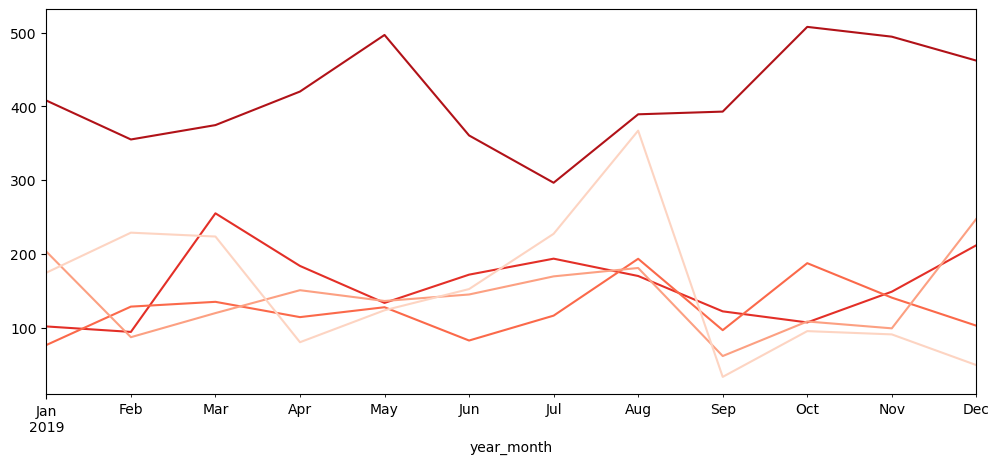

In [90]:
topfive_1 = df_trend_1[df_trend_1.Commodity.str.lower().str.contains('beef|cheese|frozen meat|deli meats|seafood-frozen')].copy()
topfive_1.Date = pd.to_datetime(topfive_1.Date, format='%Y-%m-%d')
topfive_1['year_month'] = topfive_1.Date.dt.to_period('M') 

palette = sns.color_palette("Reds", n_colors=len(topfive_1['Commodity'].unique()))[::-1]

ax = topfive_1.groupby(['Commodity', 'year_month']).agg(total_revenue=('Price', sum)).unstack('Commodity').plot(figsize=(12, 5), color=palette)

ax.legend().set_visible(False)
plt.show()

In [91]:
df_trend_2 = df_trend.loc[(df_trend['Date'] >= '2020-01-01') & (df_trend['Date'] <= '2020-12-31')]

df_trend_2

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
59838,27288,Promiscuous,2 adults with kids,45-54,private,Lunch meat,1.00,2020-01-01
59841,27288,Promiscuous,2 adults with kids,45-54,national,Soft drinks,4.19,2020-01-01
54243,26265,Loyalist,1 adult with kids,45-54,national,Dinner sausage,2.99,2020-01-01
51384,25653,Loyalist,1 adult with kids,19-24,private,Coupon/misc items,0.15,2020-01-01
48065,25020,Promiscuous,Single male,25-34,national,Salad dressing,2.50,2020-01-01
...,...,...,...,...,...,...,...,...
293,15875,Promiscuous,2 adults with kids,45-54,national,Hot dogs,1.25,2020-12-31
10378,17688,Loyalist,2 adults with no kids,19-24,national,Tropical fruit,0.62,2020-12-31
21686,20102,Promiscuous,2 adults with kids,45-54,national,Cat food,1.00,2020-12-31
15202,18686,Loyalist,Single male,19-24,national,Cheese,3.99,2020-12-31


In [92]:
# topfive_2 = df_trend_2[df_trend.Commodity.str.lower().str.contains('beef|cheese|frozen meat|deli meats|seafood-frozen')].copy()
# topfive_2.Date = pd.to_datetime(topfive_2.Date, format='%Y-%m-%d')
# topfive_2['year_month'] = topfive_2.Date.dt.to_period('M')

# topfive_2.groupby(['Commodity', 'year_month']).agg(total_revenue=('Price', sum)).unstack('Commodity')

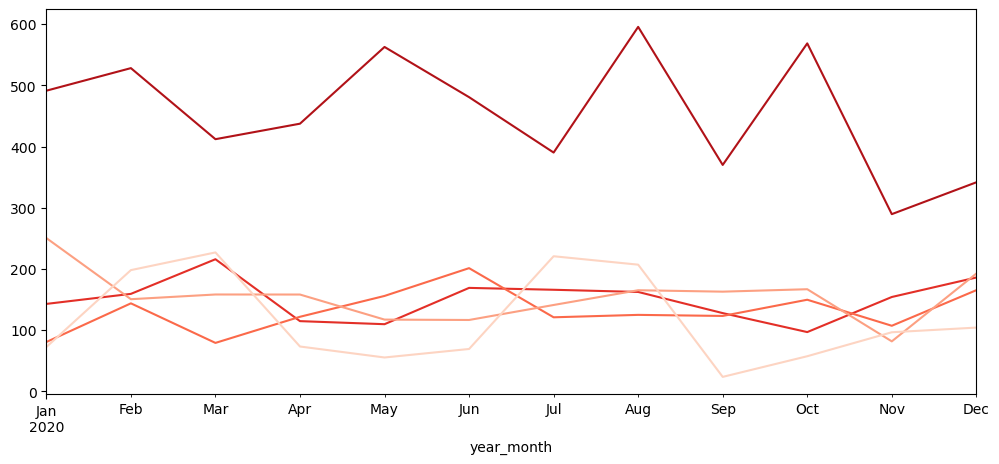

In [93]:
topfive_2 = df_trend_2[df_trend_2.Commodity.str.lower().str.contains('beef|cheese|frozen meat|deli meats|seafood-frozen')].copy()
topfive_2.Date = pd.to_datetime(topfive_2.Date, format='%Y-%m-%d')
topfive_2['year_month'] = topfive_2.Date.dt.to_period('M') 

palette = sns.color_palette("Reds", n_colors=len(topfive_2['Commodity'].unique()))[::-1]

ax = topfive_2.groupby(['Commodity', 'year_month']).agg(total_revenue=('Price', sum)).unstack('Commodity').plot(figsize=(12, 5), color=palette)

ax.legend().set_visible(False)
plt.show()

In [94]:
df_trend_3 = df_trend.loc[(df_trend['Date'] >= '2021-01-01') & (df_trend['Date'] <= '2021-12-31')]

df_trend_3

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
58095,26946,Loyalist,1 adult with kids,35-44,national,Salad,2.62,2021-01-01
46075,24650,Loyalist,1 adult with kids,25-34,national,Citrus,0.67,2021-01-01
58585,27037,Loyalist,2 adults with no kids,19-24,national,Salad,2.99,2021-01-01
50640,25511,Promiscuous,Single female,25-34,national,Cheese,2.99,2021-01-01
45400,24518,Promiscuous,2 adults with kids,45-54,national,Dinner sausage,7.98,2021-01-01
...,...,...,...,...,...,...,...,...
26530,21453,Promiscuous,2 adults with kids,45-54,national,Cakes,1.79,2021-12-31
10710,17781,Promiscuous,Single female,19-24,national,Soft drinks,5.76,2021-12-31
19458,19529,Promiscuous,2 adults with no kids,19-24,national,Soft drinks,4.19,2021-12-31
24018,20789,Loyalist,1 adult with kids,25-34,national,Tomatoes,4.63,2021-12-31


In [95]:
# topfive_3 = df_trend_3[df_trend.Commodity.str.lower().str.contains('beef|cheese|frozen meat|deli meats|seafood-frozen')].copy()
# topfive_3.Date = pd.to_datetime(topfive_3.Date, format='%Y-%m-%d')
# topfive_3['year_month'] = topfive_3.Date.dt.to_period('M')

# topfive_3.groupby(['Commodity', 'year_month']).agg(total_revenue=('Price', sum)).unstack('Commodity')

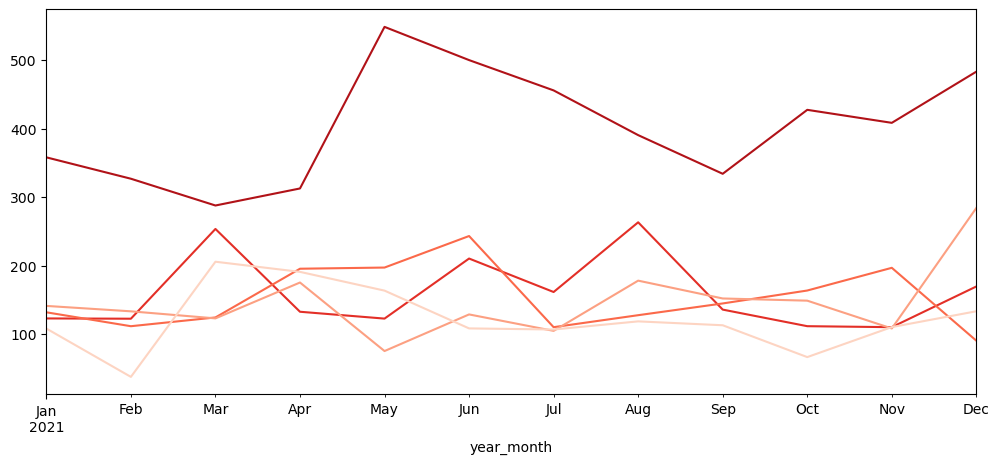

In [96]:
topfive_3 = df_trend_3[df_trend_3.Commodity.str.lower().str.contains('beef|cheese|frozen meat|deli meats|seafood-frozen')].copy()
topfive_3.Date = pd.to_datetime(topfive_3.Date, format='%Y-%m-%d')
topfive_3['year_month'] = topfive_3.Date.dt.to_period('M') 

palette = sns.color_palette("Reds", n_colors=len(topfive_3['Commodity'].unique()))[::-1]

ax = topfive_3.groupby(['Commodity', 'year_month']).agg(total_revenue=('Price', sum)).unstack('Commodity').plot(figsize=(12, 5), color=palette)

ax.legend().set_visible(False)
plt.show()

# 2022
Did not include in the data 

In [97]:
df_trend_4 = df_trend.loc[(df_trend['Date'] >= '2022-01-01') & (df_trend['Date'] <= '2022-12-31')]

df_trend_4

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
41982,23966,Loyalist,1 adult with kids,35-44,national,Makeup and treatment,5.49,2022-01-01
39802,23611,Loyalist,Single male,19-24,national,Heat/serve,2.89,2022-01-01
29415,22092,Promiscuous,1 adult with kids,19-24,national,Christmas seasonal,16.00,2022-01-01
65900,28500,Loyalist,2 adults with no kids,25-34,private,Sandwiches,7.98,2022-01-01
29964,22162,Promiscuous,2 adults with kids,45-54,national,Vegetables - all others,0.99,2022-01-01
...,...,...,...,...,...,...,...,...
57476,26800,Loyalist,2 adults with no kids,19-24,national,Baked bread/buns/rolls,2.50,2022-12-05
44489,24393,Promiscuous,1 adult with kids,19-24,national,Cheese,5.49,2022-12-05
56875,26703,Promiscuous,2 adults with kids,45-54,national,Bleach,1.79,2022-12-05
48495,25082,Loyalist,1 adult with kids,19-24,national,Frozen meat,3.29,2022-12-05


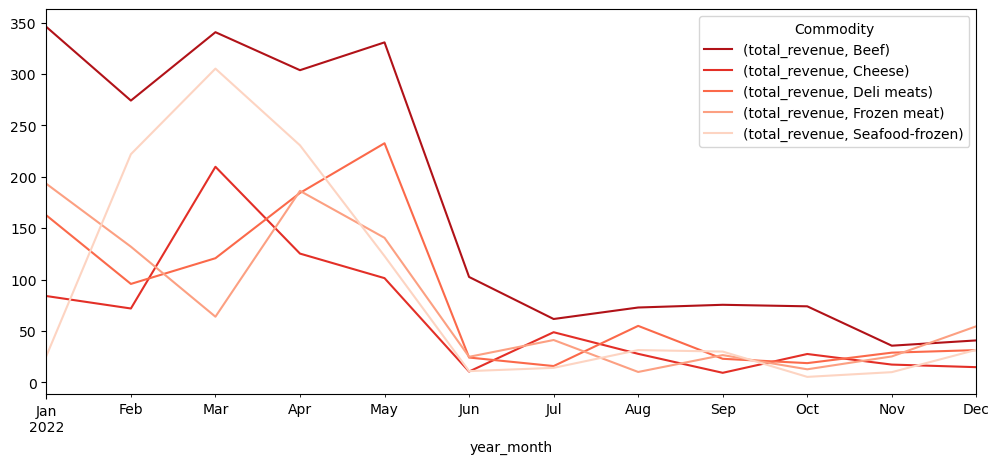

In [98]:
topfive_4 = df_trend_4[df_trend_4.Commodity.str.lower().str.contains('beef|cheese|frozen meat|deli meats|seafood-frozen')].copy()
topfive_4.Date = pd.to_datetime(topfive_4.Date, format='%Y-%m-%d')
topfive_4['year_month'] = topfive_4.Date.dt.to_period('M') 

palette = sns.color_palette("Reds", n_colors=len(topfive_3['Commodity'].unique()))[::-1]

ax = topfive_4.groupby(['Commodity', 'year_month']).agg(total_revenue=('Price', sum)).unstack('Commodity').plot(figsize=(12, 5), color=palette)
plt.legend(title='Commodity')
plt.show()

# BEEF


<Axes: xlabel='year'>

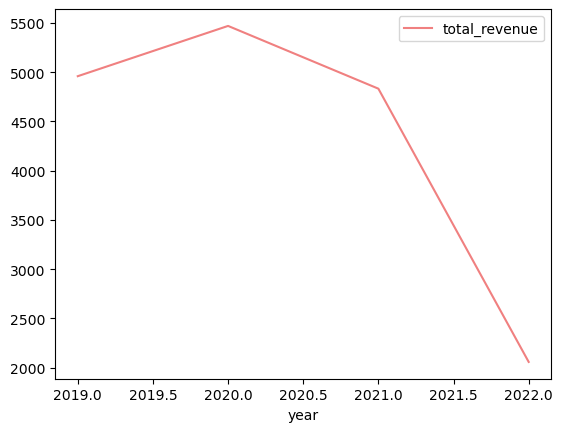

In [99]:
beef = df_trend[df_trend.Commodity == 'Beef'].copy()

beef.Date = pd.to_datetime(beef.Date, format='%d-%m-%Y')
beef['year'] = beef.Date.dt.year
beef.groupby('year').agg(total_revenue=('Price', sum)).plot(color='lightcoral')

<Axes: xlabel='year,month'>

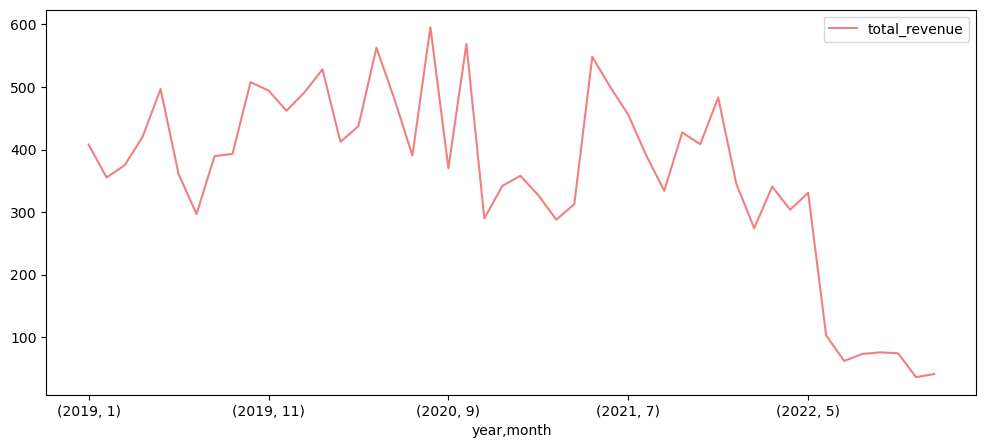

In [100]:
beef = df_trend[df_trend.Commodity == 'Beef'].copy()
beef.Date = pd.to_datetime(beef.Date, format='%Y-%m-%d')
beef['year'] = beef.Date.dt.year
beef['month'] = beef.Date.dt.month
beef.groupby(['year','month']).agg(total_revenue=('Price', sum)).plot(figsize=(12,5), color='lightcoral')

# 2019

In [101]:
df_trend_1 = df_trend.loc[(df_trend['Date'] >= '2019-01-01') & (df_trend['Date'] <= '2019-12-31')]

df_trend_1

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
37001,23087,Promiscuous,Single male,25-34,national,Crackers/misc bkd fd,2.00,2019-01-01
61881,27662,Loyalist,Single male,19-24,national,Citrus,1.20,2019-01-01
61878,27662,Loyalist,Single male,19-24,national,Bag snacks,2.49,2019-01-01
30747,22276,Promiscuous,2 adults with kids,45-54,national,Chicken,4.13,2019-01-01
56335,26599,Loyalist,2 adults with no kids,19-24,national,Disposible foilware,2.99,2019-01-01
...,...,...,...,...,...,...,...,...
26499,21450,Promiscuous,2 adults with kids,45-54,national,Canned beans,2.38,2019-12-31
6477,16970,Promiscuous,2 adults with kids,45-54,private,Fluid milk products,2.38,2019-12-31
11371,17904,Promiscuous,1 adult with kids,19-24,national,Bread,1.79,2019-12-31
11834,17987,Promiscuous,Single male,19-24,private,Beef,1.49,2019-12-31


<Axes: xlabel='month'>

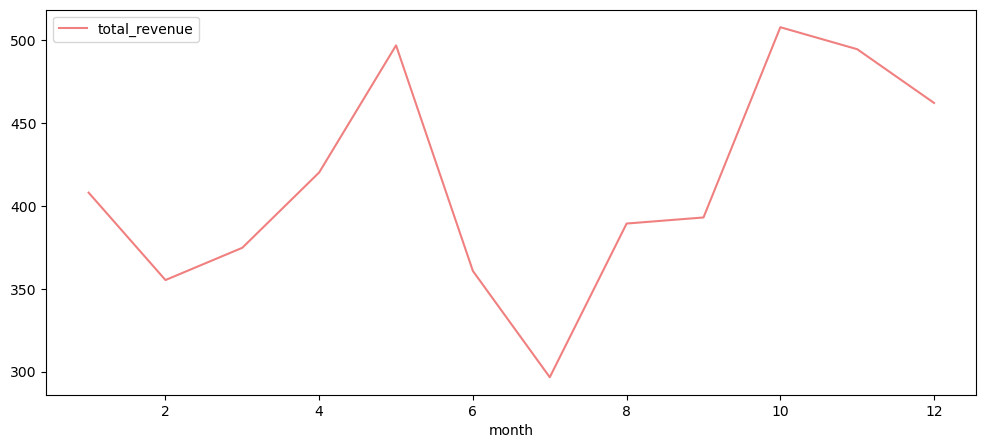

In [102]:
beef = df_trend_1[df_trend_1.Commodity == 'Beef'].copy()
beef.Date = pd.to_datetime(beef.Date, format='%Y-%m-%d')

beef['month'] = beef.Date.dt.month
beef.groupby(['month']).agg(total_revenue=('Price', sum)).plot(figsize=(12,5), color='lightcoral')


# 2020

In [103]:
df_trend_2 = df_trend.loc[(df_trend['Date'] >= '2020-01-01') & (df_trend['Date'] <= '2020-12-31')]

df_trend_2

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
59838,27288,Promiscuous,2 adults with kids,45-54,private,Lunch meat,1.00,2020-01-01
59841,27288,Promiscuous,2 adults with kids,45-54,national,Soft drinks,4.19,2020-01-01
54243,26265,Loyalist,1 adult with kids,45-54,national,Dinner sausage,2.99,2020-01-01
51384,25653,Loyalist,1 adult with kids,19-24,private,Coupon/misc items,0.15,2020-01-01
48065,25020,Promiscuous,Single male,25-34,national,Salad dressing,2.50,2020-01-01
...,...,...,...,...,...,...,...,...
293,15875,Promiscuous,2 adults with kids,45-54,national,Hot dogs,1.25,2020-12-31
10378,17688,Loyalist,2 adults with no kids,19-24,national,Tropical fruit,0.62,2020-12-31
21686,20102,Promiscuous,2 adults with kids,45-54,national,Cat food,1.00,2020-12-31
15202,18686,Loyalist,Single male,19-24,national,Cheese,3.99,2020-12-31


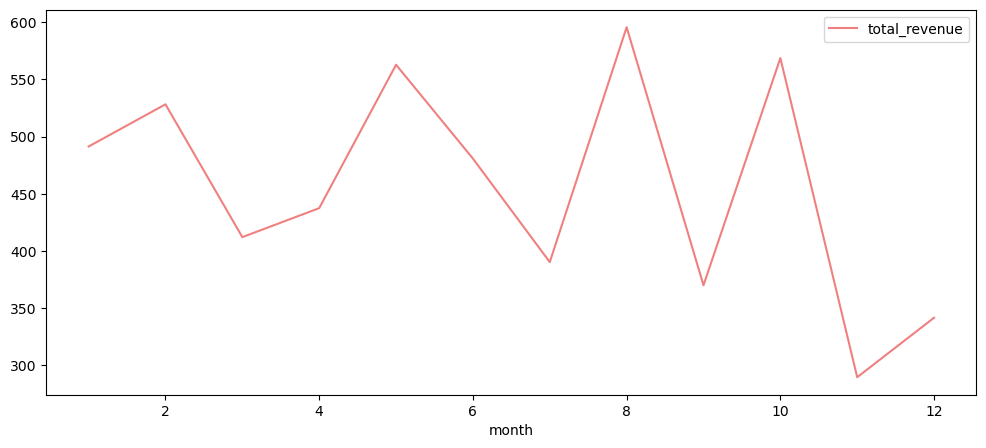

In [104]:
beef = df_trend_2[df_trend_2.Commodity == 'Beef'].copy()
beef.Date = pd.to_datetime(beef.Date, format='%Y-%m-%d')

beef['month'] = beef.Date.dt.month
beef.groupby(['month']).agg(total_revenue=('Price', sum)).plot(figsize=(12,5),color='lightcoral');

# 2021

In [105]:
df_trend_3 = df_trend.loc[(df_trend['Date'] >= '2021-01-01') & (df_trend['Date'] <= '2021-12-31')]

df_trend_3

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
58095,26946,Loyalist,1 adult with kids,35-44,national,Salad,2.62,2021-01-01
46075,24650,Loyalist,1 adult with kids,25-34,national,Citrus,0.67,2021-01-01
58585,27037,Loyalist,2 adults with no kids,19-24,national,Salad,2.99,2021-01-01
50640,25511,Promiscuous,Single female,25-34,national,Cheese,2.99,2021-01-01
45400,24518,Promiscuous,2 adults with kids,45-54,national,Dinner sausage,7.98,2021-01-01
...,...,...,...,...,...,...,...,...
26530,21453,Promiscuous,2 adults with kids,45-54,national,Cakes,1.79,2021-12-31
10710,17781,Promiscuous,Single female,19-24,national,Soft drinks,5.76,2021-12-31
19458,19529,Promiscuous,2 adults with no kids,19-24,national,Soft drinks,4.19,2021-12-31
24018,20789,Loyalist,1 adult with kids,25-34,national,Tomatoes,4.63,2021-12-31


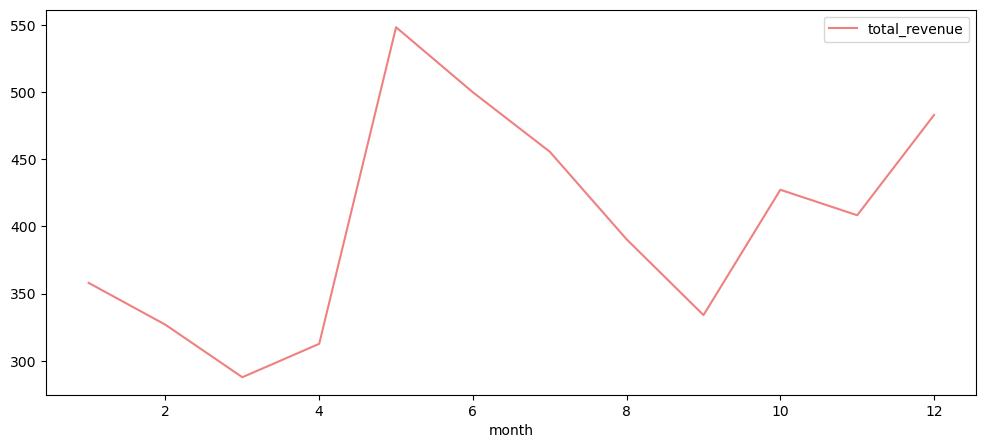

In [106]:
beef = df_trend_3[df_trend_3.Commodity == 'Beef'].copy()
beef.Date = pd.to_datetime(beef.Date, format='%Y-%m-%d')

beef['month'] = beef.Date.dt.month
beef.groupby(['month']).agg(total_revenue=('Price', sum)).plot(figsize=(12,5),color='lightcoral');

In [107]:
df_trend_4 = df_trend.loc[(df_trend['Date'] >= '2022-01-01') & (df_trend['Date'] <= '2022-12-31')]

df_trend_4

,Customer,Loyalty,Household,Age,Brand,Commodity,Price,Date
41982,23966,Loyalist,1 adult with kids,35-44,national,Makeup and treatment,5.49,2022-01-01
39802,23611,Loyalist,Single male,19-24,national,Heat/serve,2.89,2022-01-01
29415,22092,Promiscuous,1 adult with kids,19-24,national,Christmas seasonal,16.00,2022-01-01
65900,28500,Loyalist,2 adults with no kids,25-34,private,Sandwiches,7.98,2022-01-01
29964,22162,Promiscuous,2 adults with kids,45-54,national,Vegetables - all others,0.99,2022-01-01
...,...,...,...,...,...,...,...,...
57476,26800,Loyalist,2 adults with no kids,19-24,national,Baked bread/buns/rolls,2.50,2022-12-05
44489,24393,Promiscuous,1 adult with kids,19-24,national,Cheese,5.49,2022-12-05
56875,26703,Promiscuous,2 adults with kids,45-54,national,Bleach,1.79,2022-12-05
48495,25082,Loyalist,1 adult with kids,19-24,national,Frozen meat,3.29,2022-12-05


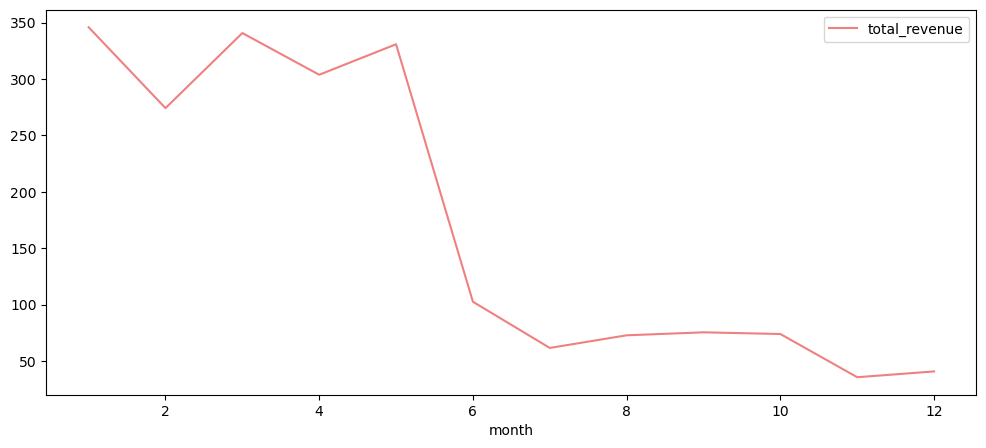

In [108]:
beef = df_trend_4[df_trend_4.Commodity == 'Beef'].copy()
beef.Date = pd.to_datetime(beef.Date, format='%Y-%m-%d')

beef['month'] = beef.Date.dt.month
beef.groupby(['month']).agg(total_revenue=('Price', sum)).plot(figsize=(12,5),color='lightcoral');